<a href="https://colab.research.google.com/github/jigyasumxkkxr/dog_breed_prediction/blob/main/Dog_Breed_Identification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Multi Class Dog Breed Classifiaction Model
#####Input: Image of Dog
#####Output: Dog Breed / Probability of that Breed

In [ ]:
#!unzip "drive/MyDrive/Dog Vision/dog-breed-identification.zip" -d "drive/MyDrive/Dog Vision"

After Unzipping the file, we have to import TensorFlow and TensorFlow Hub  

In [ ]:
import tensorflow as tf
print("TensorFlow Version:",tf.__version__)

TensorFlow Version: 2.15.0


Import `TensorFlow Hub`

In [ ]:
import tensorflow_hub as hub
print("TensorFlow Hub Version:",hub.__version__)

TensorFlow Hub Version: 0.16.1


Changing Runntime type to GPU, as running code on our CPU causes 30 times slower code run time

In [ ]:
print("GPU","Available"if tf.config.list_physical_devices("GPU") else "not available :(")

GPU Available


## Turning Images into Tensors

In [ ]:
import pandas as pd
labels_csv=pd.read_csv("drive/MyDrive/Dog Vision/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [ ]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


### Plotting all 120 Different Breeds in Order of their Frequency

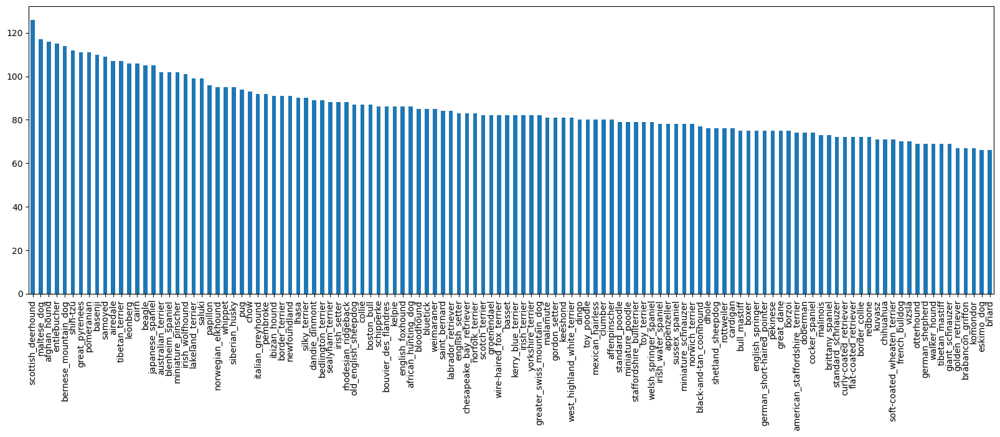

In [ ]:
labels_csv["breed"].value_counts().plot.bar(figsize=(20,6));

### Displaying Image by Importing Image funcyion from IPython.display library

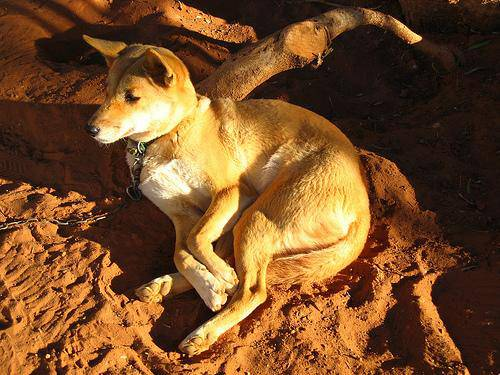

In [ ]:
from IPython.display import Image
Image("drive/MyDrive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

### Making a array `filenames` consisting of path of every jpg file

In [ ]:
filenames=["drive/MyDrive/Dog Vision/train/"+fnames+".jpg" for fnames in labels_csv["id"]]
filenames[:10]

['drive/MyDrive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog Vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog Vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog Vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog Vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog Vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

### Importing os to count number of files in Train set using os.listdir(`path`)

In [ ]:
import os
if(len(os.listdir("drive/MyDrive/Dog Vision/train/"))==len(filenames)):
  print("Proceed!!")
else:
  print("Number of Images is not Equal to total files")

Proceed!!


#### Making an numpy array of  all Breeds

In [ ]:
import numpy as np
labels = labels_csv["breed"].to_numpy() # convert labels column to NumPy array
labels[:10]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound'], dtype=object)

#### Making an numpy array of all Unique breeds (`120` in count)

In [ ]:
unique_breeds = np.unique(labels)
len(unique_breeds)

120

### Making a Boolean numpy array where the spacific breed of dog, ex. labels[0], existed in unique_breeds array

In [ ]:
print(labels[0])
labels[0] == unique_breeds # use comparison operator to create boolean array

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

### Looping the same previous code for full labels array

In [ ]:
boolean_labels = [label == np.array(unique_breeds) for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

### Validating that the specific breed lies on same index for Unique_breeds and previously created boolean_labels array and converting boolean array to int array

In [ ]:
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])[0][0])
print(boolean_labels[0].argmax())
print(boolean_labels[0].astype(int))

boston_bull
19
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Spliting Data Using sklearn Model_selection modeule

In [ ]:
X=filenames
y=boolean_labels

### As Traning 10222 files might take long time so let start with 1000 images

### Creating a slider for inputting the number of images to traing the model by:
`@param {type:"slider",min:1000,max:10000,step:1000}`

In [ ]:
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

### Spliting Train Dataset into Training and Validating sts

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)
len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

##### Checking training Data

In [ ]:
X_train[:5], y_train[:2]

(['drive/MyDrive/Dog Vision/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/Dog Vision/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  'drive/MyDrive/Dog Vision/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  'drive/MyDrive/Dog Vision/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  'drive/MyDrive/Dog Vision/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, 

## Preprocessing Images Data (Turning Images into Tensors)
To preprocess our images into Tensors we're going to write a function which does a few things:
1. Takes an image filename as input.
2. Uses TensorFlow to read the file and save it to a variable, `image`.
3. Turn our `image` (a jpg file) into Tensors.
4. Resize the `image` to be of shape (224, 224).
5. Return the modified `image`.

###  Convert image to numpy array

In [ ]:
from matplotlib.pyplot import imread
image=imread(filenames[50])
image.shape

(240, 320, 3)

array([[[176, 163, 146],
        [157, 144, 127],
        [148, 135, 118],
        ...,
        [109,  94,  97],
        [ 76,  60,  70],
        [ 75,  59,  70]],

       [[168, 155, 138],
        [148, 135, 118],
        [150, 137, 120],
        ...,
        [100,  86,  86],
        [ 64,  49,  56],
        [ 86,  70,  80]],

       [[149, 133, 117],
        [128, 112,  96],
        [144, 131, 114],
        ...,
        [108,  94,  93],
        [ 73,  57,  60],
        [ 67,  50,  56]],

       ...,

       [[ 92,  75,  65],
        [ 87,  70,  60],
        [ 76,  62,  53],
        ...,
        [253, 241, 217],
        [255, 241, 220],
        [255, 243, 222]],

       [[ 89,  72,  62],
        [ 86,  69,  59],
        [ 77,  63,  52],
        ...,
        [252, 241, 221],
        [251, 238, 221],
        [249, 236, 219]],

       [[ 85,  68,  58],
        [ 87,  70,  60],
        [ 83,  69,  58],
        ...,
        [255, 245, 227],
        [253, 240, 224],
        [249, 236, 220]]], dtype=uint8)
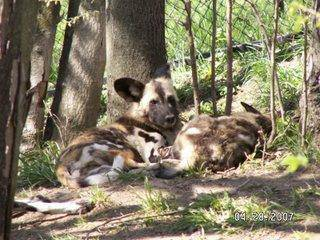

In [ ]:
image

#### Max of Image i.e 255 (Max of RGB Pallet)

In [ ]:
image.max()

255

#### Min of Image i.e 0 (Min of RGB Pallet)

In [ ]:
image.min()

0

### Converting Image to Tensors using `tf.constant("variable")` Function to be run on GPU

In [ ]:
tf.constant(image)

<tf.Tensor: shape=(240, 320, 3), dtype=uint8, numpy=
array([[[176, 163, 146],
        [157, 144, 127],
        [148, 135, 118],
        ...,
        [109,  94,  97],
        [ 76,  60,  70],
        [ 75,  59,  70]],

       [[168, 155, 138],
        [148, 135, 118],
        [150, 137, 120],
        ...,
        [100,  86,  86],
        [ 64,  49,  56],
        [ 86,  70,  80]],

       [[149, 133, 117],
        [128, 112,  96],
        [144, 131, 114],
        ...,
        [108,  94,  93],
        [ 73,  57,  60],
        [ 67,  50,  56]],

       ...,

       [[ 92,  75,  65],
        [ 87,  70,  60],
        [ 76,  62,  53],
        ...,
        [253, 241, 217],
        [255, 241, 220],
        [255, 243, 222]],

       [[ 89,  72,  62],
        [ 86,  69,  59],
        [ 77,  63,  52],
        ...,
        [252, 241, 221],
        [251, 238, 221],
        [249, 236, 219]],

       [[ 85,  68,  58],
        [ 87,  70,  60],
        [ 83,  69,  58],
        ...,
        [255, 245, 22

In [ ]:
tf.constant(image[:2])

<tf.Tensor: shape=(2, 320, 3), dtype=uint8, numpy=
array([[[176, 163, 146],
        [157, 144, 127],
        [148, 135, 118],
        ...,
        [109,  94,  97],
        [ 76,  60,  70],
        [ 75,  59,  70]],

       [[168, 155, 138],
        [148, 135, 118],
        [150, 137, 120],
        ...,
        [100,  86,  86],
        [ 64,  49,  56],
        [ 86,  70,  80]]], dtype=uint8)>

### Preprocessing Function

In [ ]:
Img_size=224

def process_image(image_path):
  """
  Turns Image into Tensors
  """
  image=tf.io.read_file(image_path)
  image=tf.image.decode_jpeg(image, channels=3)
  image=tf.image.convert_image_dtype(image, tf.float32)
  image=tf.image.resize(image,size=[Img_size,Img_size])
  return image

### Inputting Image and its label and returning a tuple of Processed image and associated Label

In [ ]:
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label

### Example of previous function

In [ ]:
get_image_label(X[42],tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

### Batching our Data Set to a batch of 32
1. If the data is a test dataset,Slice only filenames and map images to batch.
2. If the data if a valid dataset,Slice filenames and labels and then mapp images to batch.
3. If the data is a training dataset, Slice filenames and labels then shuffles dataset and then mapp images to batch


In [ ]:
BATCH_SIZE = 32

def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """

  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch


  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:

    print("Creating training data batches...")

    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                              tf.constant(y))) # labels

    data = data.shuffle(buffer_size=len(x))

    data = data.map(get_image_label)

    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [ ]:
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


### Specification of elements of data sets previously made having:
1. Image=shape=(`Batch`=None i.e 32,`height`=224,`width`=224,`RGB`=3)
2. label=shape=(`Batch`=None i.e 32,`len(label)`=120)

In [ ]:
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

### Visualising Our Dataset using Matplotlib

In [ ]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(12,12))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn gird lines off
    plt.axis("off")

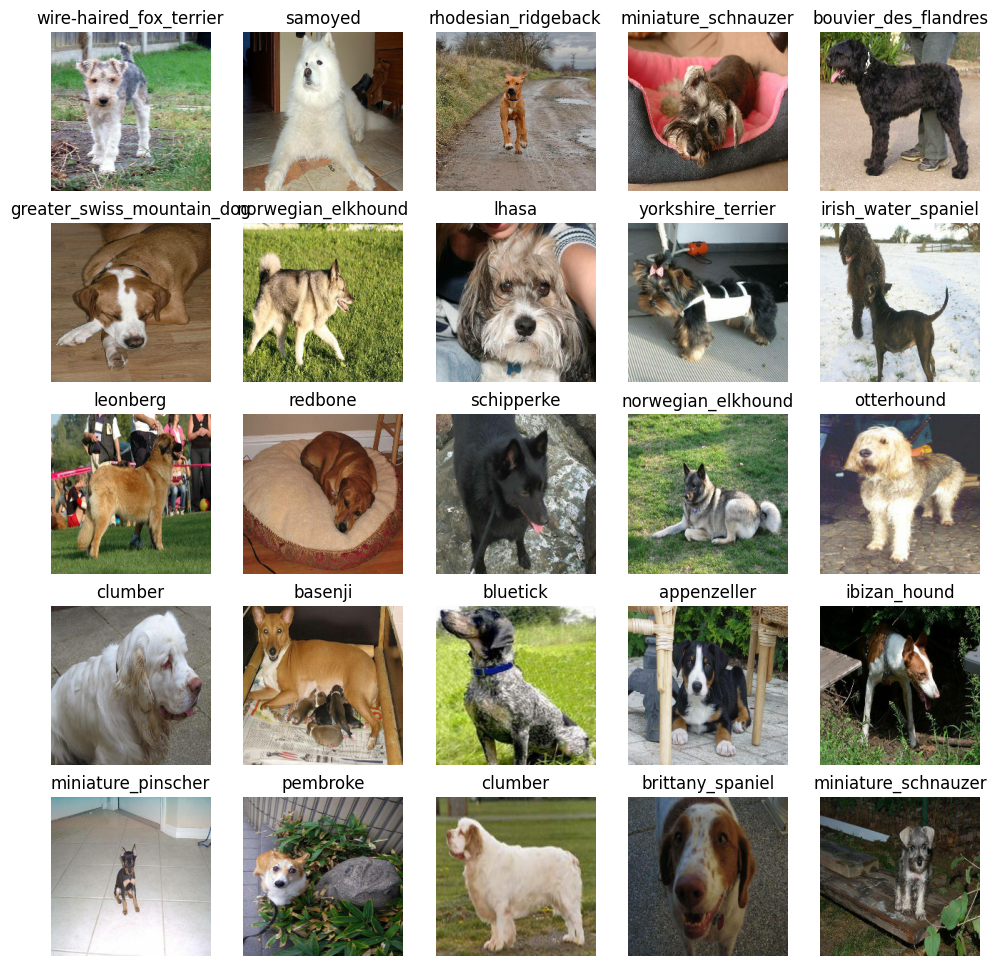

In [ ]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

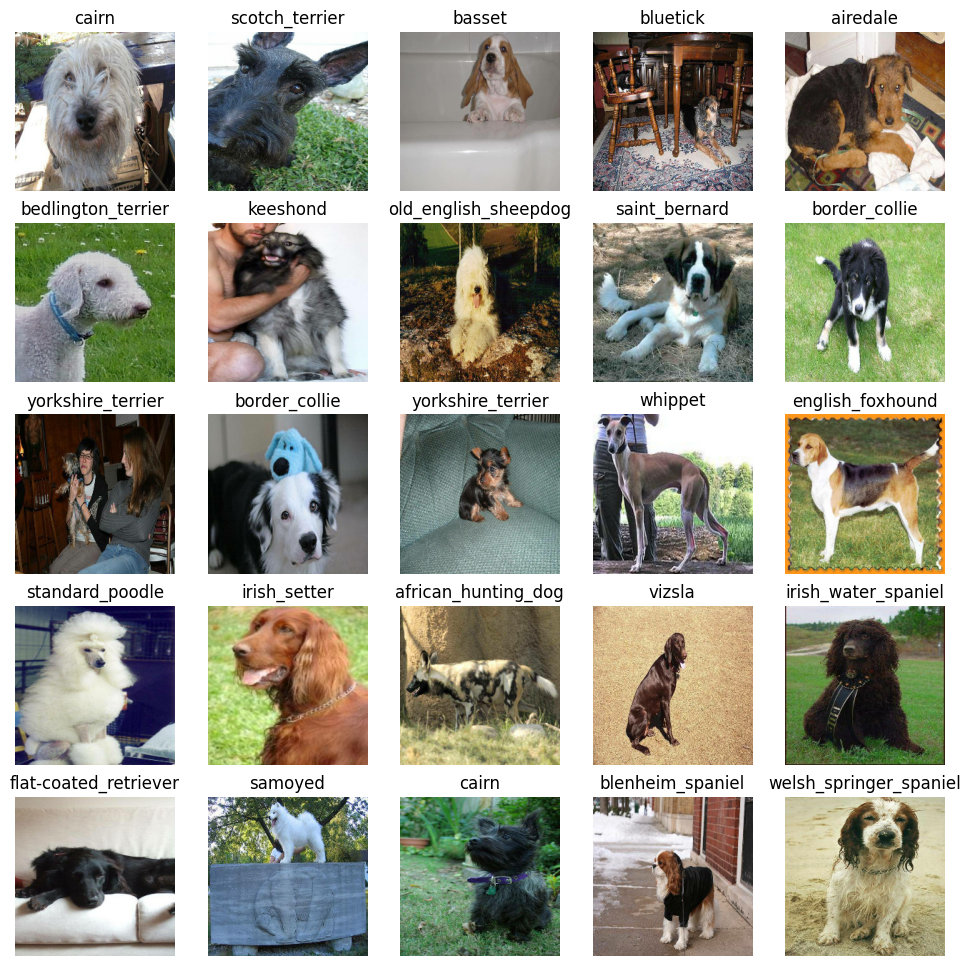

In [ ]:
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

### Defining Input and Output Shape , Model URL Importted from TensorFlow Hub Under Mobile_Net

In [ ]:
Input_Shape=[None,Img_size,Img_size,3] # None for Batches,Height,width,color channels
Output_Shape=len(unique_breeds)
Model_URL="https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2"

### Model Creation Function
1. Making layers of model i.e Input layer and output layer
2. Compiling model with loss, optimizer and metrices
Transferring this to `model.compile()` terminology:
* `loss` - The height of the hill is the loss function, the models goal is to minimize this, getting to 0 (the bottom of the hill) means the model is learning perfectly.
* `optimizer` - Your friend Adam is the optimizer, he's the one telling you how to navigate the hill (lower the loss function) based on what you've done so far. His name is Adam because the [Adam optimizer](https://machinelearningmastery.com/adam-optimization-algorithm-for-deep-learning/) is a great general which performs well on most models. Other optimizers include [RMSprop](https://ruder.io/optimizing-gradient-descent/index.html#rmsprop) and [Stochastic Gradient Descent](https://en.wikipedia.org/wiki/Stochastic_gradient_descent).
* `metrics` - This is the onlooker at the bottom of the hill rating how well your perfomance is. Or in our case, giving the accuracy of how well our model is predicting the correct image label.
3. Building Model

In [ ]:
def create_model(input_shape=Input_Shape,output_shape=Output_Shape,model_url=Model_URL):
  print("Building Model with:",model_url)

  # Setup Model Layers
  model = tf.keras.Sequential([
    hub.KerasLayer(model_url), # Layer 1 (input layer)
    tf.keras.layers.Dense(units=output_shape,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this (how wrong its guesses are)
      optimizer=tf.keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics=["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(input_shape) # Let the model know what kind of inputs it'll be getting

  return model

In [ ]:
model=create_model()
model.summary()

Building Model with: https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


### Loading TensorBoard log Extention

In [ ]:
%load_ext tensorboard

### Creating a tensorboard_callback that Stores logs to log directory

In [ ]:
import datetime

def create_tensorboard_callback():
  logdir=os.path.join("drive/MyDrive/Dog Vision/logs",
                      datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

### Early Stopping Callback
Early stopping helps prevent overfitting by stopping a model when a certain evaluation metric stops improving.

In [ ]:
early_stopping=tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                patience=3)

### Defining number of epochs
Passing data for finding patterns `Num_Epochs` times

In [ ]:
Num_Epochs=100 #@param {type:"slider",min:10,max:100,step:10}

### Train Model Function

In [ ]:
def train_model():
  model=create_model()
  tensorboard_callback=create_tensorboard_callback()
  model.fit(x=train_data,
            epochs=Num_Epochs,
            validation_data=val_data,
            validation_freq=1, # check validation metrics every epoch
            callbacks=[tensorboard_callback, early_stopping])
  return model

### Model

In [ ]:
model = train_model()

Building Model with: https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2
Epoch 1/100
25/25 [==============================] - 120s 3s/step - loss: 4.5708 - accuracy: 0.0862 - val_loss: 3.3028 - val_accuracy: 0.3050
Epoch 2/100
25/25 [==============================] - 4s 141ms/step - loss: 1.6312 - accuracy: 0.6812 - val_loss: 2.1427 - val_accuracy: 0.5200
Epoch 3/100
25/25 [==============================] - 4s 142ms/step - loss: 0.5587 - accuracy: 0.9350 - val_loss: 1.6533 - val_accuracy: 0.6000
Epoch 4/100
25/25 [==============================] - 4s 170ms/step - loss: 0.2504 - accuracy: 0.9875 - val_loss: 1.4798 - val_accuracy: 0.6450
Epoch 5/100
25/25 [==============================] - 4s 161ms/step - loss: 0.1468 - accuracy: 0.9962 - val_loss: 1.4031 - val_accuracy: 0.6650
Epoch 6/100
25/25 [==============================] - 5s 186ms/step - loss: 0.1007 - accuracy: 0.9975 - val_loss: 1.3604 - val_accuracy: 0.6600
Epoc

### Checking Tensorboard logs
using tensorboard magic function `%tensorboard`

In [ ]:
%tensorboard --logdir drive/MyDrive/Dog\ Vision/logs

<IPython.core.display.Javascript object>

### Making and Evaluating predictions

In [ ]:
predictions=model.predict(val_data,verbose=1)
predictions

7/7 [==============================] - 2s 109ms/step


array([[5.0744009e-03, 7.2488416e-05, 4.0935776e-03, ..., 3.8735615e-03,
        1.1230750e-04, 2.1195679e-03],
       [3.4072918e-03, 1.3854956e-04, 1.8721441e-02, ..., 2.1120081e-04,
        2.5658756e-03, 4.6056844e-05],
       [3.9669962e-06, 4.5311498e-04, 4.7767855e-04, ..., 2.4885523e-05,
        3.5125078e-05, 1.0236210e-04],
       ...,
       [2.9244993e-06, 3.3590582e-06, 2.8920904e-06, ..., 2.3160235e-06,
        6.3305932e-05, 1.4422640e-04],
       [2.1952481e-03, 1.9942947e-04, 6.6016219e-05, ..., 1.2028678e-04,
        4.4943990e-05, 1.3110256e-02],
       [3.4820684e-04, 1.6492510e-05, 4.4762524e-04, ..., 7.5307679e-03,
        8.2529098e-04, 6.1552491e-05]], dtype=float32)

200 images in validation dataset and 120 unique breeds

In [ ]:
predictions.shape

(200, 120)

Means `predictions` stores probability of each breed to be that of image and its sum is 1

In [ ]:
np.sum(predictions[0])

1.0

### Predicting

In [ ]:
def properties(index):
  print(f"Max Probability in predictions[{index}]:{np.max(predictions[index])}")
  print(f"Sum:{np.sum(predictions[index])}")
  print(f"Max Index:{np.argmax(predictions[index])}")
  print(f"Breed:{unique_breeds[np.argmax(predictions[index])]}")

In [ ]:
properties(0)

Max Probability in predictions[0]:0.319179892539978
Sum:1.0
Max Index:17
Breed:border_terrier


In [ ]:
properties(5)

Max Probability in predictions[5]:0.9590608477592468
Sum:1.0
Max Index:10
Breed:bedlington_terrier


### Function to return label of arg_max

In [ ]:
def get_pred_label(predictions_probabilites):
  """
  Turns max probability to labels of that breed
  """
  return unique_breeds[np.argmax(predictions_probabilites)]

In [ ]:
breed_prob=get_pred_label(predictions[81])
breed_prob

'dingo'

### UnBatching Dataset

In [ ]:
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []

  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels


Unbatchify Val dataset

In [ ]:
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [ ]:
len(val_images)

200

In [ ]:
len(val_labels)

200

In [ ]:
unique_breeds[np.argmax(predictions[0])]

'border_terrier'

### Plotting and visualising our probability

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  pred_label = get_pred_label(pred_prob)

  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

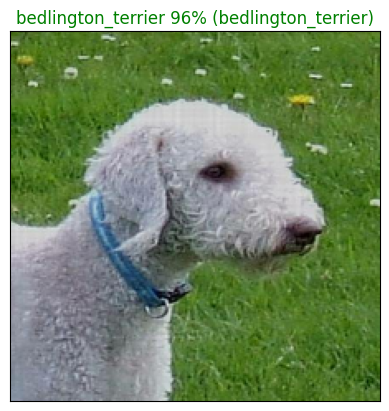

In [ ]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=5)

### Ploting Probabilities bar graph

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

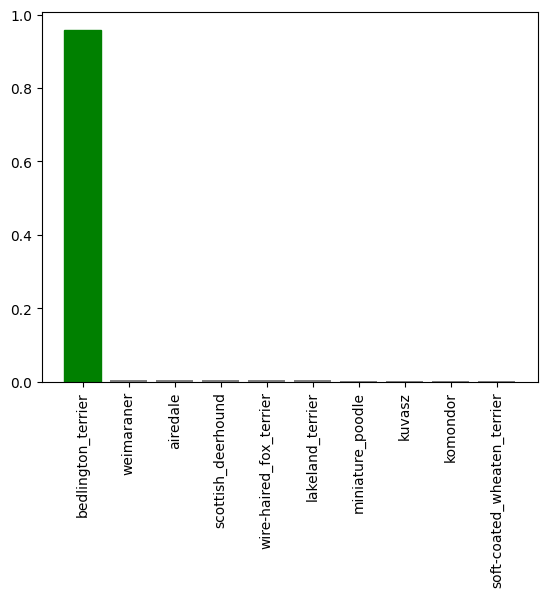

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=5)

### Visualising few Predictions

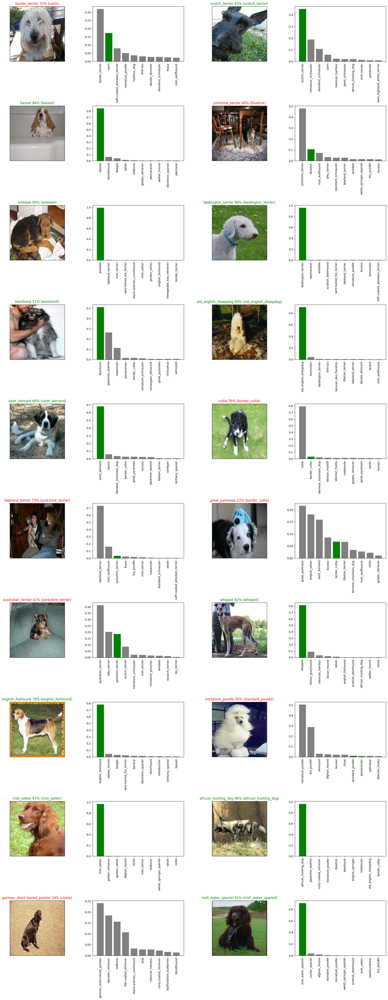

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 10
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

### Saving and Loading Model

In [ ]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/MyDrive/Dog Vision/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [ ]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
save_model(model, suffix="1000-images-Adam")

Saving model to: drive/MyDrive/Dog Vision/models/20240215-19351708025724-1000-images-Adam.h5...


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/Dog Vision/models/20240215-19351708025724-1000-images-Adam.h5'

In [ ]:
model_1000_images = load_model('drive/MyDrive/Dog Vision/models/20240215-19351708025724-1000-images-Adam.h5')

Loading saved model from: drive/MyDrive/Dog Vision/models/20240215-19351708025724-1000-images-Adam.h5


In [ ]:
model.evaluate(val_data)
model_1000_images.evaluate(val_data)

7/7 [==============================] - 3s 195ms/step - loss: 1.2545 - accuracy: 0.6750


[1.2545254230499268, 0.675000011920929]

### Training model using Whole Data

In [ ]:
len(X),len(y)

(10222, 10222)

In [ ]:
X[:10]

['drive/MyDrive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog Vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog Vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog Vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog Vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog Vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
y[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
full_data = create_data_batches(X, y)

Creating training data batches...


In [ ]:
full_model=create_model()

Building Model with: https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2


In [ ]:
full_model_tensorboard=create_tensorboard_callback()
full_model_early_stopping=tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                           patience=3)

In [ ]:
%tensorboard --logdir drive/MyDrive/Dog\ Vision/logs

Reusing TensorBoard on port 6006 (pid 6386), started 0:10:20 ago. (Use '!kill 6386' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
full_model.fit(x=full_data,
               epochs=Num_Epochs,
               callbacks=[full_model_tensorboard,
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 44s 127ms/step - loss: 1.3521 - accuracy: 0.6682
Epoch 2/100
320/320 [==============================] - 41s 129ms/step - loss: 0.3995 - accuracy: 0.8805
Epoch 3/100
320/320 [==============================] - 41s 129ms/step - loss: 0.2329 - accuracy: 0.9392
Epoch 4/100
320/320 [==============================] - 40s 126ms/step - loss: 0.1526 - accuracy: 0.9644
Epoch 5/100
320/320 [==============================] - 40s 125ms/step - loss: 0.1054 - accuracy: 0.9793
Epoch 6/100
320/320 [==============================] - 40s 124ms/step - loss: 0.0782 - accuracy: 0.9858
Epoch 7/100
320/320 [==============================] - 41s 128ms/step - loss: 0.0574 - accuracy: 0.9928
Epoch 8/100
320/320 [==============================] - 40s 125ms/step - loss: 0.0465 - accuracy: 0.9951
Epoch 9/100
320/320 [==============================] - 39s 122ms/step - loss: 0.0382 - accuracy: 0.9955
Epoch 10/100
320/320 [==============================] - 41s 127m

In [ ]:
save_model(full_model, suffix="all-images-Adam")

Saving model to: drive/MyDrive/Dog Vision/models/20240215-20011708027272-all-images-Adam.h5...


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/Dog Vision/models/20240215-20011708027272-all-images-Adam.h5'

In [ ]:
loaded_full_model = load_model('drive/MyDrive/Dog Vision/models/20240215-20011708027272-all-images-Adam.h5')

Loading saved model from: drive/MyDrive/Dog Vision/models/20240215-20011708027272-all-images-Adam.h5


### Prediction Based on Test Data

In [ ]:
test_path = "drive/MyDrive/Dog Vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['drive/MyDrive/Dog Vision/test/f0fc06a2b2123325e34a2450d3202853.jpg',
 'drive/MyDrive/Dog Vision/test/eabbab9c853d5b0893e45ec8fd3f97d0.jpg',
 'drive/MyDrive/Dog Vision/test/ea5bd02a78f243c609cd227c4a09c6c4.jpg',
 'drive/MyDrive/Dog Vision/test/f3094b103a8d45b2c1026f2d5bb4c687.jpg',
 'drive/MyDrive/Dog Vision/test/ed67035dba2de274aa95556038113c40.jpg',
 'drive/MyDrive/Dog Vision/test/ecb6362d105c0cb84d8e69cfd9b8d0b5.jpg',
 'drive/MyDrive/Dog Vision/test/f43a0698255ee6f04ad91702a4376b6c.jpg',
 'drive/MyDrive/Dog Vision/test/ed67681e7935d75f9ce011dbf8474fe4.jpg',
 'drive/MyDrive/Dog Vision/test/e8232c9a79f0e77e9b4c5fca60682d41.jpg',
 'drive/MyDrive/Dog Vision/test/f1c1f35ca91cd9d007f957da29aa087e.jpg']

In [ ]:
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [ ]:
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 1694s 5s/step


In [ ]:
test_predictions[:10]

array([[2.2348695e-07, 1.1951619e-07, 4.7124904e-09, ..., 9.0841812e-10,
        2.9169114e-10, 6.1513617e-08],
       [1.9061207e-07, 2.4086763e-08, 9.7444754e-08, ..., 2.1642859e-06,
        2.1285953e-06, 1.6238291e-05],
       [2.2466586e-09, 1.8059693e-11, 1.7084695e-10, ..., 2.9965148e-09,
        1.6177570e-09, 2.7302371e-09],
       ...,
       [2.4899549e-07, 1.1141280e-09, 8.3721288e-09, ..., 6.8520017e-06,
        1.1000042e-03, 1.3586145e-08],
       [2.3325753e-12, 2.4322230e-07, 2.0555775e-10, ..., 3.5133549e-10,
        2.6420809e-08, 2.8461473e-09],
       [2.9433467e-10, 9.2419926e-11, 7.4874220e-07, ..., 1.5460017e-10,
        1.6975825e-09, 1.1918468e-10]], dtype=float32)